In [6]:
import numpy as np
import pandas as pd
from matplotlib import pyplot
from mpl_toolkits.mplot3d import axes3d
%matplotlib inline

In [7]:
data = pd.read_csv('diabetes.csv')
data

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [8]:
columns = ['Glucose','Insulin']
dataNuevo = data[columns]
dataNuevo.head(20)

,Glucose,Insulin
0,148,0
1,85,0
2,183,0
3,89,94
4,137,168
5,116,0
6,78,88
7,115,0
8,197,543
9,125,0


In [12]:
x,y = dataNuevo['Insulin'], dataNuevo['Glucose']
m=y.size

In [13]:
print(x)

0        0
1        0
2        0
3       94
4      168
      ... 
763    180
764      0
765    112
766      0
767      0
Name: Insulin, Length: 768, dtype: int64


In [15]:
print(y)

0      148
1       85
2      183
3       89
4      137
      ... 
763    101
764    122
765    121
766    126
767     93
Name: Glucose, Length: 768, dtype: int64


In [16]:
x.size

768

In [24]:
def plotGraficar(x,y):
    fig = pyplot.figure()

    pyplot.plot(x,y,'bo',ms=9,mec='k')
    pyplot.ylabel('Glusose')
    pyplot.xlabel('Insulin')

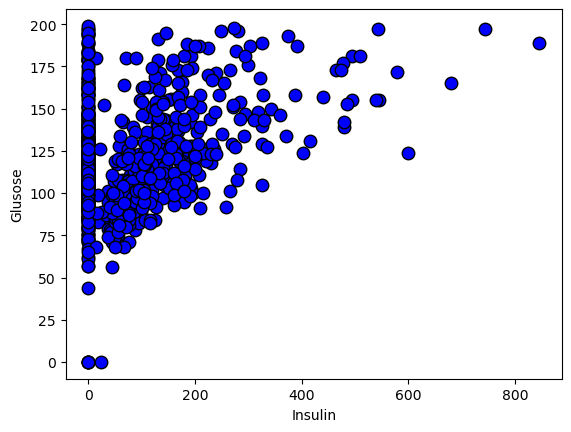

In [27]:
plotGraficar(x,y)
pyplot.show()

DESCENSO POR EL GRADIENTE


In [28]:
x = np.stack([np.ones(m),x], axis=1)

In [29]:
print(x)

[[  1.   0.]
 [  1.   0.]
 [  1.   0.]
 ...
 [  1. 112.]
 [  1.   0.]
 [  1.   0.]]


CALCULO DEL COSTO

In [32]:
def funcionCosto(x,y,theta):
    m=y.size
    j=0
    j=(1/(2*m)*np.sum(np.square(np.dot(x,theta)-y)))
    return j

In [37]:
j = funcionCosto(x,y,theta=np.array([0.0,0.0]))
print('resultado: %.2f'%j)

j = funcionCosto(x,y,theta=np.array([0.4787,0.4787]))
print('resultado: %.2f'%j)
j = funcionCosto(x,y,theta=np.array([0.9,0.9]))
print('resultado: %.2f'%j)
j = funcionCosto(x,y,theta=np.array([1.2,1.2]))
print('resultado: %.2f'%j)

resultado: 7818.20
resultado: 4826.21
resultado: 5945.34
resultado: 8883.69


In [39]:
def gradiente(x,y,theta,alpha,num_iters):
    m = y.shape[0]
    theta = theta.copy()
    j_history = []

    for i in range(num_iters):
        theta = theta - (alpha/m)*(np.dot(x,theta)-y).dot(x)
        j_history.append(funcionCosto(x,y,theta))
    return theta, j_history

In [49]:
theta = np.zeros(2)
iterations = 1500000
alpha = 0.1

theta , j_history = gradiente(x,y,theta,alpha,iterations)
print(j_history)

[np.float64(11580323140.656038), np.float64(4.458764188392531e+16), np.float64(1.7167556663478368e+23), np.float64(6.610015451389443e+29), np.float64(2.545050826047752e+36), np.float64(9.799196015199625e+42), np.float64(3.7729793669158945e+49), np.float64(1.4527082916896893e+56), np.float64(5.593355212194088e+62), np.float64(2.1536066606592766e+69), np.float64(8.292020572418935e+75), np.float64(3.1926723867194153e+82), np.float64(1.2292729956345396e+89), np.float64(4.7330634489216597e+95), np.float64(1.8223689685751636e+102), np.float64(7.016657802004203e+108), np.float64(2.7016201197126476e+115), np.float64(1.0402033955755118e+122), np.float64(4.005089746969723e+128), np.float64(1.5420776311162834e+135), np.float64(5.937453516961567e+141), np.float64(2.286094652741963e+148), np.float64(8.802138402204899e+154), np.float64(3.389082790541625e+161), np.float64(1.3048967917010076e+168), np.float64(5.024237359275189e+174), np.float64(1.9344795084851787e+181), np.float64(7.448316433220663e+1

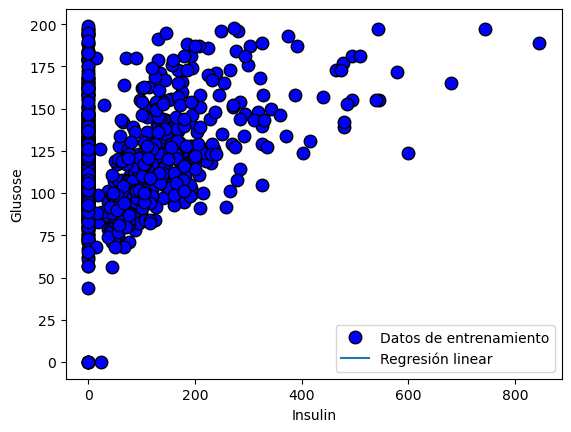

In [50]:
plotGraficar(x[:,1],y)
pyplot.plot(x[:,1], np.dot(x,theta),'-')
pyplot.legend(['Datos de entrenamiento', 'Regresión linear'])
pyplot.show()